##### This notebook preprocesses the initial training set and creates a cleaned version of the training set to be provided to the clustering algorithm.
In more detail it contains the following steps:
1. It explores the initial dataframe to remove unnecessary rows and columns
2. It runs dataprep and identifies basic preprocessing
3. It implements basic preprocessing actions on the corresponding features
4. It implements preprocessing on the surveys' granularity
5. It runs dataprep, identifies and reports the preprocessing actions need per each feature individually
6. It drops features that exceed a specific NaN threshold
7. It drops records that exceed a specific NaN threshold
8. It implements the preprocessing actions identified on step 4
9. It implements additional preprocessing and engineering actions


In [30]:
import time
import warnings
import numpy as np
import pandas as pd
from dataprep.eda import create_report
from sklearn.preprocessing import MinMaxScaler
import sys
sys.path.append('../')
from functions import training_set_preprocessing

warnings.filterwarnings("ignore")

Load the initial training set

In [76]:
training_df = pd.read_pickle('../data/preprocessing_final/training_df_daily_unprocessed.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badge_type,badge_value,calories,distance,lightly_active_minutes,...,minutes_awake,minutes_after_wakeup,time_in_bed,sleep_efficiency,consciousness_raising_category,counterconditioning_category,helping_relationships_category,stimulus_control_category,step_goal,place
0,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
1,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
2,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,OTHER
3,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,HOME
4,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,ENTERTAINMENT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14430,621e362467b776a2404ad513,2021-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14431,621e362467b776a2404ad513,2021-05-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
14432,621e36f967b776a240e5e7c9,2021-05-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,WORK/SCHOOL
14433,621e36f967b776a240e5e7c9,2021-05-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,WORK/SCHOOL


##### 1. Explore the initial dataframe to remove unnecessary rows and columns
- Does the encoded dataframe contains duplicates?
- How many users do they participate in the training process based on the encoded dataframe?
- Does the encoded dataframe contains rows only with NaNs?
- Does the encoded dataframe contains columns only with NaNs?
- How many records derived out of official experiment days and do they affect this work?

In [77]:
# check for duplicates based on all features
# Finding: 928 exact duplicate have been found - when all features were present there were not duplicates, but after features splitting this one duplicate has appeared.
# Approach: Drop them
training_df.drop_duplicates(inplace=True)
training_df

,id,date,sleep_points,exertion_points,altitude,badge_type,badge_value,calories,distance,lightly_active_minutes,...,minutes_awake,minutes_after_wakeup,time_in_bed,sleep_efficiency,consciousness_raising_category,counterconditioning_category,helping_relationships_category,stimulus_control_category,step_goal,place
0,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
1,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
2,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,OTHER
3,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,HOME
4,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,ENTERTAINMENT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14429,621e362467b776a2404ad513,2021-05-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14430,621e362467b776a2404ad513,2021-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14431,621e362467b776a2404ad513,2021-05-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
14432,621e36f967b776a240e5e7c9,2021-05-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,WORK/SCHOOL


In [78]:
# find the users that are participating in the training
print(training_df['id'].nunique(), "users are participating in the training process.")

71 users are participating in the training process.


In [79]:
# find rows with no information - 5110 such rows have been found
columns = list(training_df.loc[:, 'sleep_points':].columns)
cleaned_training_df = training_df[~training_df[columns].isnull().all(1)]
cleaned_training_df

,id,date,sleep_points,exertion_points,altitude,badge_type,badge_value,calories,distance,lightly_active_minutes,...,minutes_awake,minutes_after_wakeup,time_in_bed,sleep_efficiency,consciousness_raising_category,counterconditioning_category,helping_relationships_category,stimulus_control_category,step_goal,place
0,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
1,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
2,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,OTHER
3,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,HOME
4,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,ENTERTAINMENT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14429,621e362467b776a2404ad513,2021-05-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14430,621e362467b776a2404ad513,2021-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14431,621e362467b776a2404ad513,2021-05-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
14432,621e36f967b776a240e5e7c9,2021-05-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,WORK/SCHOOL


In [80]:
# find columns with no information - as expected 0 such columns have been found
for col in columns:
    if cleaned_training_df[col].isnull().all():
        cleaned_training_df.drop(columns=col, inplace=True)
cleaned_training_df

,id,date,sleep_points,exertion_points,altitude,badge_type,badge_value,calories,distance,lightly_active_minutes,...,minutes_awake,minutes_after_wakeup,time_in_bed,sleep_efficiency,consciousness_raising_category,counterconditioning_category,helping_relationships_category,stimulus_control_category,step_goal,place
0,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
1,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
2,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,OTHER
3,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,HOME
4,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,ENTERTAINMENT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14429,621e362467b776a2404ad513,2021-05-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14430,621e362467b776a2404ad513,2021-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14431,621e362467b776a2404ad513,2021-05-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
14432,621e36f967b776a240e5e7c9,2021-05-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,WORK/SCHOOL


In [81]:
# find how many records derived out of the official experiment dates and if affect this work
training_set_preprocessing.experiments_dates(cleaned_training_df)

There are 2414 rows out of experiment dates from 69 unique users with 'normal distribution'.


In [82]:
cleaned_training_df.to_pickle('../data/preprocessing_temps/cleaned_daily_training_df.pkl')

##### 2. Run dataprep and identify basic preprocessing

In [83]:
training_df = pd.read_pickle('../data/preprocessing_temps/cleaned_daily_training_df.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badge_type,badge_value,calories,distance,lightly_active_minutes,...,minutes_awake,minutes_after_wakeup,time_in_bed,sleep_efficiency,consciousness_raising_category,counterconditioning_category,helping_relationships_category,stimulus_control_category,step_goal,place
0,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
1,621e2ff067b776a2403eb737,2021-12-22,NaN,NaN,170.0,NaN,NaN,2436.54,434050.0,238.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
2,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,OTHER
3,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,HOME
4,621e2ff067b776a2403eb737,2021-11-18,NaN,NaN,110.0,NaN,NaN,2501.45,701570.0,314.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4999,ENTERTAINMENT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14429,621e362467b776a2404ad513,2021-05-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14430,621e362467b776a2404ad513,2021-05-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HOME
14431,621e362467b776a2404ad513,2021-05-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TRANSIT
14432,621e36f967b776a240e5e7c9,2021-05-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,WORK/SCHOOL


In [ ]:
report = create_report(training_df, title='Daily Training Dataframe')
report

##### 3. Implement basic preprocessing

step_goal preprocessing

In [84]:
# convert from categorical to numerical
training_df['step_goal'].replace(to_replace=['NO_GOAL'], value=[0], inplace=True)
training_df['step_goal'] = training_df['step_goal'].astype(float)

consciousness_raising, counterconditioning, helping_relationships and stimulus_control preprocessing

In [85]:
# replace with 0,1,2 (ordinal relationship)
for feature in ['consciousness_raising_category', 'counterconditioning_category', 'helping_relationships_category', 'stimulus_control_category']:
    training_df[feature].replace(to_replace=['Below average', 'Average', 'Above average'], value=[0, 1 ,2], inplace=True)

place preprocessing

In [86]:
# one-hot-encoding
s = training_df['place']
dum = pd.get_dummies(s.apply(pd.Series).stack()).sum(level=0)
df = pd.concat([s, dum], axis=1)
training_df = pd.concat([training_df, df], axis=1)
training_df = training_df.drop(columns='place')

minutes to fall asleep

In [87]:
training_df['minutes_to_fall_asleep'] = training_df['minutes_to_fall_asleep'].astype(float)

mindfulness_goal

In [88]:
training_df['mindfulness_goal'] = training_df['mindfulness_goal'].astype(float)

badges

In [89]:
training_df.drop(columns=['badge_type'], inplace=True)
training_df.rename(columns={'badge_value': 'badges'}, inplace=True)

In [ ]:
report = create_report(training_df, title='Daily Training Dataframe')
report

In [91]:
training_df.to_pickle('../data/preprocessing_temps/basic_preprocessed_daily_training_df.pkl')

##### 4. Preprocess the different surveys' granularity

In [92]:
start = time.time()
print("Loading and sorting ... ")
training_df = pd.read_pickle('../data/preprocessing_temps/basic_preprocessed_daily_training_df.pkl')
training_df = training_df.sort_values(['id', 'date'], ignore_index=True)
print("finished after", time.time() - start)
training_df

Loading and sorting ... 
finished after 0.013523340225219727


,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,mindfulness_goal,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,NaN,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,NaN,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,NaN,...,NaN,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,NaN,...,NaN,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [93]:
# if the user has answered only once, copy this value for all the records of the user, else if the user has answered twice, copy for the first month the first answer and for the rest of its records copy the second answer
behavior_granularities = ['consciousness_raising_category', 'counterconditioning_category', 'helping_relationships_category', 'stimulus_control_category'] # 4

In [94]:
start = time.time()
print("Copy value for behavior features ... ")
for _, user_df in training_df.groupby(['id']):
    for feature in behavior_granularities:
        non_null_feature = user_df[feature].notnull().any()
        if non_null_feature: # if it has value
            unique_values = user_df[feature].dropna().unique() # find the number of unique values

            if len(unique_values) == 1: # if it has only one value copy the value in all of its records
                training_df.loc[(training_df['id'] == user_df['id'].iloc[0]), feature] = unique_values[0]
            elif len(unique_values) >= 2: # if it has more than one values

                # find the earliest answer
                earliest_non_nan_date = user_df['date'].loc[user_df[feature].notna()].min()
                earliest_value = user_df[feature].loc[user_df['date'] == earliest_non_nan_date].iloc[0]

                if len(unique_values) > 2: # if accidentally user has more than 2 answers, keep the first and the last
                    # find the latest answer
                    latest_non_nan_date = user_df['date'].loc[user_df[feature].notna()].max()
                    latest_value = user_df[feature].loc[user_df['date'] == latest_non_nan_date].iloc[0]
                    unique_values = [earliest_value, latest_value]

                # create a mask for the next 30 days that the first answer will be copied
                next_30_days_mask = (training_df['id'] == user_df['id'].iloc[0]) & (training_df['date'] < earliest_non_nan_date + pd.DateOffset(days=30))
                training_df.loc[next_30_days_mask, feature] = earliest_value

                # copy the second answer in all the other records
                training_df.loc[(training_df['id'] == user_df['id'].iloc[0]), feature] = training_df.loc[(training_df['id'] == user_df['id'].iloc[0]), feature].fillna(unique_values[1])
print("finished after", time.time() - start)
training_df

Copy value for behavior features ... 
finished after 0.8690855503082275


,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,mindfulness_goal,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,NaN,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [95]:
training_df.to_pickle('../data/preprocessing_temps/surveys_preprocessed_daily_training.pkl')

##### 5. Run dataprep, identify and report the final preprocessing actions

In [96]:
training_df = pd.read_pickle('../data/preprocessing_temps/surveys_preprocessed_daily_training.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,mindfulness_goal,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,NaN,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


  0%|          | 0/8090 [00:00<?, ?it/s]

Granularity preprocessed
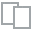
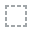
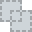
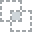
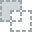
...
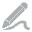
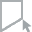
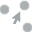
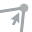
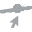

In [97]:
report = create_report(training_df, title='Granularity preprocessed')
report

##### 6. Drop features that exceed a specific threshold for NaN values

In [3]:
training_df = pd.read_pickle('../data/preprocessing_temps/surveys_preprocessed_daily_training.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,mindfulness_goal,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,NaN,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,NaN,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
nan_percentages = training_df.isna().mean()
drop_columns = nan_percentages[nan_percentages > 0.8].index.tolist()
if not drop_columns:
    print("No columns have more than 80% NaN values.")
else:
    print("The columns with more than 80% NaN values are:", drop_columns)

The columns with more than 80% NaN values are: ['badges', 'mindfulness_goal', 'water_amount', 'deep', 'light', 'rem', 'wake', 'sleep_duration', 'minutes_to_fall_asleep', 'minutes_asleep', 'minutes_awake', 'minutes_after_wakeup', 'time_in_bed', 'sleep_efficiency']


Drop the features

In [6]:
drop_columns.remove('sleep_duration')
drop_columns.remove('badges')
training_df.drop(columns=drop_columns, inplace=True)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,24.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,27.0,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
training_df.to_pickle('../data/preprocessing_temps/dropped_columns_daily_training_df.pkl')

##### 7. Drop records that exceed a specific threshold for NaN values

In [9]:
training_df = pd.read_pickle('../data/preprocessing_temps/dropped_columns_daily_training_df.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,24.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,27.0,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
threshold = int(0.8 * len(training_df.columns))
dropped_records_training_df = training_df[training_df.isnull().sum(axis=1) <= threshold]
dropped_records_training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,24.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,27.0,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
dropped_records_training_df.to_pickle('../data/preprocessing_temps/dropped_rows_daily_training_df.pkl')

##### 8. Implement the final preprocessing

In [12]:
training_df = pd.read_pickle('../data/preprocessing_temps/dropped_rows_daily_training_df.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.0,27.0,220.0,NaN,2351.59,651750.0,149.0,24.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.0,29.0,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.0,29.0,300.0,NaN,2262.30,609090.0,112.0,27.0,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.0,29.0,240.0,1.0,2325.10,665310.0,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,NaN,NaN,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


For the features below replace all the NaN and 0 values with the user mean if available, otherwise with the general mean

In [13]:
nan_0_with_mean = ['exertion_points', 'sleep_points'] # 2

In [14]:
training_df = training_set_preprocessing.replace_nan_0_with_mean(training_df, nan_0_with_mean)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,NaN,2351.59,651750.0,149.0,24.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,NaN,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,NaN,2262.30,609090.0,112.0,27.0,...,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.0,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,NaN,NaN,1296.00,NaN,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


For the features below replace all the NaN values with 0

In [15]:
nan_with_0 = ['altitude', 'step_goal', 'ENTERTAINMENT', 'GYM', 'HOME', 'HOME_OFFICE', 'OTHER', 'OUTDOORS', 'TRANSIT', 'WORK/SCHOOL', 'badges', 'exercise', 'exercise_duration', 'sleep_duration'] # 14

In [16]:
training_df = training_set_preprocessing.replace_nan_with_0(training_df, nan_with_0)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,0.0,2351.59,651750.0,149.0,24.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.0,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,0.0,2262.30,609090.0,112.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.0,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,0.0,0.0,1296.00,NaN,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,0.0,0.0,1296.00,NaN,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,0.0,0.0,1296.00,NaN,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,0.0,0.0,1296.00,NaN,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


For the features below replace all the NaN values with the user mean if available, otherwise with the general mean

In [17]:
nan_with_mean = ['distance', 'lightly_active_minutes', 'moderately_active_minutes', 'sedentary_minutes', 'steps', 'very_active_minutes', 'minutes_below_zone_1', 'minutes_in_zone_1', 'minutes_in_zone_2', 'minutes_in_zone_3', 'calories'] # 11

In [18]:
training_df = training_set_preprocessing.replace_nan_with_mean(training_df, nan_with_mean)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,0.0,2351.59,651750.000000,149.0,24.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,0.0,2262.30,609090.000000,112.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.000000,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


For the features below replace all the NaN values with the most common value of all the other users

In [19]:
nan_with_common = ['consciousness_raising_category', 'counterconditioning_category', 'helping_relationships_category', 'stimulus_control_category'] # 4

In [20]:
training_df = training_set_preprocessing.replace_nan_with_common(training_df, nan_with_common)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,0.0,2351.59,651750.000000,149.0,24.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,0.0,2262.30,609090.000000,112.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.000000,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Convert the categorical into numerical features

In [21]:
categoricals = ['consciousness_raising_category', 'counterconditioning_category', 'helping_relationships_category', 'stimulus_control_category', 'ENTERTAINMENT', 'GYM', 'HOME', 'HOME_OFFICE', 'OTHER', 'OUTDOORS', 'TRANSIT', 'WORK/SCHOOL']

In [22]:
for categorical in categoricals:
    training_df[categorical] = training_df[categorical].astype(float)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,0.0,2351.59,651750.000000,149.0,24.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,0.0,2262.30,609090.000000,112.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.000000,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [23]:
training_df.to_pickle('../data/preprocessing_temps/final_preprocessed_daily_training_df.pkl')

In [ ]:
report = create_report(training_df, title='Final preprocessed')
report

Manual check for NaN values and categorical features in the whole dataframe

In [25]:
# check for NaN values
if training_df.isna().any().any():
    print("There are some NaN values in the dataset.")
else:
    print("There are no NaN values in the whole dataset!")

There are no NaN values in the whole dataset!


In [26]:
# check for categorical features and values
if training_df.applymap(lambda x: isinstance(x, float)).all().all():
    print("There are some categorical values (and probably features) in the dataset.")
else:
    print("There are no categorical values and features in the whole dataset!")

There are no categorical values and features in the whole dataset!


##### 9. Implement the additional preprocessing and engineering actions

In [33]:
training_df = pd.read_pickle('../data/preprocessing_temps/final_preprocessed_daily_training_df.pkl')
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,stimulus_control_category,step_goal,ENTERTAINMENT,GYM,HOME,HOME_OFFICE,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,0.0,2351.59,651750.000000,149.0,24.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,0.0,2262.30,609090.000000,112.0,27.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.000000,133.0,21.0,...,0.0,14999.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Date engineering (calculate day and hour sin and cos transformations, weekdays and weekends, and holidays)

In [34]:
training_df = training_set_preprocessing.date_engineering(training_df)
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL,is_weekend,is_holiday,day_sin,hour_sin,day_cos,hour_cos
0,621e2e8e67b776a24055b564,2021-05-24,25.00000,27.000000,220.0,0.0,2351.59,651750.000000,149.0,24.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.988468,0.0,0.151428,1.0
1,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,0.0,0.0,1.0,0.0,0.0,-0.937752,0.0,0.347305,1.0
2,621e2e8e67b776a24055b564,2021-05-25,25.00000,29.000000,250.0,0.0,2332.08,717860.000000,132.0,25.0,...,0.0,1.0,0.0,0.0,0.0,0.0,-0.937752,0.0,0.347305,1.0
3,621e2e8e67b776a24055b564,2021-05-26,29.00000,29.000000,300.0,0.0,2262.30,609090.000000,112.0,27.0,...,0.0,1.0,0.0,0.0,0.0,0.0,-0.848644,0.0,0.528964,1.0
4,621e2e8e67b776a24055b564,2021-05-27,28.00000,29.000000,240.0,1.0,2325.10,665310.000000,133.0,21.0,...,0.0,0.0,0.0,1.0,0.0,0.0,-0.724793,0.0,0.688967,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.485302,0.0,-0.874347,1.0
8393,621e375b67b776a240290cdc,2021-08-14,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.299363,0.0,-0.954139,1.0
8394,621e375b67b776a240290cdc,2021-08-15,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,1.0,0.101168,0.0,-0.994869,1.0
8395,621e375b67b776a240290cdc,2021-08-16,21.61194,30.492537,0.0,0.0,1296.00,749404.166667,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,-0.101168,0.0,-0.994869,1.0


In [35]:
training_df.to_pickle('../data/preprocessing_temps/date_engineered_daily_training_df.pkl')

Normalize the dataframe

In [36]:
training_df = pd.read_pickle('../data/preprocessing_temps/date_engineered_daily_training_df.pkl')

In [37]:
min_max_scaler = MinMaxScaler()
features = list(training_df.columns)
features.remove('id')
features.remove('date')
for feature in features:
    training_df[[feature]] = min_max_scaler.fit_transform(training_df[[feature]])
training_df

,id,date,sleep_points,exertion_points,altitude,badges,calories,distance,lightly_active_minutes,moderately_active_minutes,...,OTHER,OUTDOORS,TRANSIT,WORK/SCHOOL,is_weekend,is_holiday,day_sin,hour_sin,day_cos,hour_cos
0,621e2e8e67b776a24055b564,2021-05-24,0.809989,0.623032,0.065476,0.000000,0.280325,0.218337,0.254701,0.083045,...,0.0,0.0,0.0,0.0,0.0,0.0,0.005131,0.0,5.746227e-01,0.0
1,621e2e8e67b776a24055b564,2021-05-25,0.809989,0.681027,0.074405,0.000000,0.277999,0.240483,0.225641,0.086505,...,0.0,0.0,0.0,1.0,0.0,0.0,0.030521,0.0,6.728133e-01,0.0
2,621e2e8e67b776a24055b564,2021-05-25,0.809989,0.681027,0.074405,0.000000,0.277999,0.240483,0.225641,0.086505,...,0.0,1.0,0.0,0.0,0.0,0.0,0.030521,0.0,6.728133e-01,0.0
3,621e2e8e67b776a24055b564,2021-05-26,0.961998,0.681027,0.089286,0.000000,0.269678,0.204045,0.191453,0.093426,...,0.0,1.0,0.0,0.0,0.0,0.0,0.075133,0.0,7.638763e-01,0.0
4,621e2e8e67b776a24055b564,2021-05-27,0.923996,0.681027,0.071429,0.076923,0.277166,0.222879,0.227350,0.072664,...,0.0,0.0,0.0,1.0,0.0,0.0,0.137138,0.0,8.440835e-01,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8392,621e375b67b776a240290cdc,2021-08-13,0.681236,0.724307,0.000000,0.000000,0.154455,0.251051,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.742963,0.0,6.041634e-02,0.0
8393,621e375b67b776a240290cdc,2021-08-14,0.681236,0.724307,0.000000,0.000000,0.154455,0.251051,0.000000,0.000000,...,0.0,0.0,0.0,0.0,1.0,0.0,0.649874,0.0,2.041741e-02,0.0
8394,621e375b67b776a240290cdc,2021-08-15,0.681236,0.724307,0.000000,0.000000,0.154455,0.251051,0.000000,0.000000,...,0.0,0.0,0.0,0.0,1.0,1.0,0.550649,0.0,5.551115e-17,0.0
8395,621e375b67b776a240290cdc,2021-08-16,0.681236,0.724307,0.000000,0.000000,0.154455,0.251051,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.449351,0.0,0.000000e+00,0.0


In [7]:
training_df.to_pickle('../data/preprocessing_temps/preprocessed_training_df_daily.pkl')